# Leases

Experimenting with plotting Oil & Gas leases in west Texas using Bokeh & GeoPandas

Using [Walktrhough: Mapping Basics with Bokeh and GeoPandas in Python](https://towardsdatascience.com/walkthrough-mapping-basics-with-bokeh-and-geopandas-in-python-43f40aa5b7e9) as a guide

Data source from [Texas General Land Office](https://www.glo.texas.gov/land/land-management/gis/)

## 1. Initial imports

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

## 2. Read in lease shapefile using geopandas

In [2]:
activeleases = gpd.read_file('../data/ActiveLeases/ActiveLeases.shp')

In [3]:
activeleases.head()

,VIEWID,LEASE_NUMB,LEASE_STAT,LEASE_ST_1,EFFECTIVE_,PRIMARY_TE,BONUS_AMOU,ORIGINAL_G,ORIGINAL_N,CURRENT_GR,...,FIRST_WE_3,FIRST_WE_4,LEASE_UPDA,LEASE_INPU,LAND_TYPE,COUNTY,OBJECTID_1,Shape_Leng,Shape_Area,geometry
0,42100606,MF103278,Producing,05/13/2003,05/13/2003,05/13/2004,0.0,640.000,640.000,10.000,...,None,None,Oct 3 2017 9:12AM,Sep 10 2003 2:26PM,07,Pecos,131985,804.671762,4.046854e+04,"POLYGON ((-11442520.707 3655779.265, -11442364..."
1,42100608,MF103279,Producing,03/01/2003,08/18/1999,08/18/2002,10.0,320.000,0.000,0.000,...,None,None,Mar 3 2005 11:58AM,Sep 15 2003 2:21PM,08,Loving,797,5641.390753,1.761222e+06,"POLYGON ((-11515603.720 3750381.922, -11514718..."
2,42100742,MF103280,Producing,09/02/2003,09/02/2003,09/02/2005,2229.0,14.860,14.860,14.860,...,None,None,Jan 19 2012 12:18PM,Oct 28 2003 2:12PM,01,Fayette,547,1964.636972,7.380327e+04,"POLYGON ((-10785622.612 3491212.249, -10785626..."
3,42100819,MF103285,Producing,02/01/2004,08/20/2003,08/20/2004,136000.0,2720.000,0.000,0.000,...,None,None,Mar 30 2005 10:03AM,Dec 2 2003 10:44AM,07,Pecos,1620,24878.146652,1.499048e+07,"MULTIPOLYGON (((-11447998.873 3555025.238, -11..."
4,42100745,MF103288,Producing,04/01/2001,08/09/2000,08/09/2002,0.0,2922.743,730.685,2922.743,...,None,None,May 16 2013 10:10AM,Oct 31 2003 11:19AM,18,Burleson,1763,6837.338144,1.460012e+06,"POLYGON ((-10729416.996 3569583.378, -10729481..."


Test plot the first lease

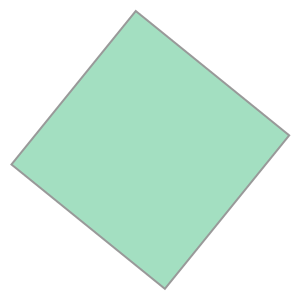

In [4]:
activeleases.iloc[0]['geometry']

Cast the geometry as a string to see how the shapely geometry is represented

In [5]:
str(activeleases.iloc[0]['geometry'])

'POLYGON ((-11442520.7074 3655779.264700003, -11442364.4179 3655652.607199997, -11442491.0466 3655496.294299997, -11442647.3361 3655622.951800004, -11442520.7074 3655779.264700003))'

These look like XY coordinates in feet

List the column names in the file to see what data are available per lease

In [6]:
from pprint import pprint

In [7]:
pprint(activeleases.columns)

Index(['VIEWID', 'LEASE_NUMB', 'LEASE_STAT', 'LEASE_ST_1', 'EFFECTIVE_',
       'PRIMARY_TE', 'BONUS_AMOU', 'ORIGINAL_G', 'ORIGINAL_N', 'CURRENT_GR',
       'CURRENT_NE', 'LEASE_TYPE', 'BONUS_AM_1', 'PRIMARY__1', 'ORIGINAL_L',
       'LESSOR', 'FIELD_NAME', 'UNDIVIDED_', 'UNITIZED', 'ALL_DEPTHS',
       'DEPTH_FROM', 'DEPTH_TO', 'DEP_FROM_F', 'DEP_TO_FOR', 'DEPTH_LAND',
       'DEPTH_FR_1', 'DEPTH_TO_T', 'LEASE_ROYA', 'LEASE_RO_1', 'LEASE_RO_2',
       'APPLICATIO', 'FIRST_WELL', 'FIRST_WE_1', 'FIRST_WE_2', 'FIRST_WE_3',
       'FIRST_WE_4', 'LEASE_UPDA', 'LEASE_INPU', 'LAND_TYPE', 'COUNTY',
       'OBJECTID_1', 'Shape_Leng', 'Shape_Area', 'geometry'],
      dtype='object')


In [8]:
activeleases.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 7700 entries, 0 to 7699
Data columns (total 44 columns):
VIEWID        7700 non-null int64
LEASE_NUMB    7699 non-null object
LEASE_STAT    7699 non-null object
LEASE_ST_1    7685 non-null object
EFFECTIVE_    7691 non-null object
PRIMARY_TE    7145 non-null object
BONUS_AMOU    7700 non-null float64
ORIGINAL_G    7700 non-null float64
ORIGINAL_N    7700 non-null float64
CURRENT_GR    7700 non-null float64
CURRENT_NE    7700 non-null float64
LEASE_TYPE    7322 non-null object
BONUS_AM_1    7700 non-null float64
PRIMARY__1    7699 non-null object
ORIGINAL_L    7189 non-null object
LESSOR        6647 non-null object
FIELD_NAME    350 non-null object
UNDIVIDED_    7646 non-null object
UNITIZED      7699 non-null object
ALL_DEPTHS    4943 non-null object
DEPTH_FROM    905 non-null object
DEPTH_TO      815 non-null object
DEP_FROM_F    415 non-null object
DEP_TO_FOR    623 non-null object
DEPTH_LAND    148 non-null object
DEPTH_FR_1 

In [9]:
activeleases.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
VIEWID,7700.0,4.209988e+07,4.800155e+05,0.000000,4.209939e+07,4.210970e+07,4.211540e+07,4.212026e+07
BONUS_AMOU,7700.0,1.500244e+05,6.852147e+05,0.000000,5.284000e+02,6.122500e+03,4.204388e+04,1.788700e+07
ORIGINAL_G,7700.0,2.999056e+02,1.033160e+03,0.000000,5.530000e+00,3.909000e+01,3.200000e+02,3.456000e+04
ORIGINAL_N,7700.0,1.940515e+02,8.963646e+02,0.000000,0.000000e+00,2.975000e+00,8.000000e+01,3.456000e+04
CURRENT_GR,7700.0,1.786334e+02,7.725165e+02,0.000000,0.000000e+00,9.690000e-01,8.000000e+01,3.051872e+04
CURRENT_NE,7700.0,2.309937e+02,8.012550e+02,0.000000,3.863750e+00,2.278500e+01,2.033965e+02,3.032811e+04
BONUS_AM_1,7700.0,5.065463e+02,1.790725e+03,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,3.012300e+04
OBJECTID_1,7700.0,3.752827e+04,6.363892e+04,1.000000,2.195750e+03,4.753500e+03,3.616950e+04,2.277000e+05
Shape_Leng,7700.0,5.439726e+03,8.226842e+03,52.470128,1.864600e+03,3.766544e+03,6.845063e+03,3.525858e+05
Shape_Area,7700.0,1.467121e+06,4.579903e+06,50.796035,3.488757e+04,2.077394e+05,1.661740e+06,1.727921e+08


## 3. Vizualize data using bokeh

In [17]:
import json
from bokeh.io import show, output_notebook
from bokeh.models import (CDSView, ColorBar, ColumnDataSource,
                          CustomJS, CustomJSFilter, 
                          GeoJSONDataSource, HoverTool,
                          LinearColorMapper, Slider)
from bokeh.layouts import column, row, widgetbox
from bokeh.palettes import brewer
from bokeh.plotting import figure

from bokeh.tile_providers import get_provider, Vendors
tile_provider = get_provider(Vendors.CARTODBPOSITRON_RETINA)

output_notebook()

Loading BokehJS ...

In [29]:
def create_lease_map(source):
    p = figure(title = 'Active Oil & Gas Leases in Texas, March 2020', 
               plot_height = 600,
               plot_width = 950, 
               toolbar_location = 'below',
               tools = "box_select,tap,pan,box_zoom,reset",
               match_aspect = True)
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    #Add the background tile (uncomment this line to add the map background)
    p.add_tile(tile_provider)
    # Add patch renderer to figure.
    leases = p.patches('xs','ys', source = source,
                       fill_color = 'yellow',
                       line_color = 'black', 
                       line_width = 0.25, 
                       fill_alpha = 1)
    # Create hover tool
    p.add_tools(HoverTool(renderers = [leases],
                          tooltips = [('Lease Number','@LEASE_NUMB'),
                                     ('County','@COUNTY'), 
                                     ('Lessor','@LESSOR'),
                                     ('Field Name','@FIELD_NAME')]))
    return p

In [23]:
def plot_leases(gdf):
   
    df = gdf
    
    # Input GeoJSON source that contains features for plotting
    geosource = GeoJSONDataSource(geojson = df.to_json())
    
    #lat = df['LAT'].values
    #long = df['LON'].values
    
    return show(create_lease_map(geosource))

In [30]:
plot_leases(activeleases)